# Intro

In [31]:
!pip install GPUtil

  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Created wheel for GPUtil: filename=GPUtil-1.4.0-py3-none-any.whl size=7394 sha256=b1d17bfb59c6f9b2bb0587c8de7dc953bac0372843e042219afacfd96ef21167
  Stored in directory: c:\users\apoghosyan\appdata\local\pip\cache\wheels\2b\b5\24\fbb56595c286984f7315ee31821d6121e1b9828436021a88b3
Successfully built GPUtil


In [32]:
import GPUtil
GPUtil.getAvailable()

[]

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

from sklearn.ensemble import AdaBoostClassifier, RandomForestClassifier
from sklearn.svm import SVC
from sklearn.decomposition import PCA

from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import classification_report, auc, classification_report, precision_recall_curve
from sklearn.inspection import permutation_importance
from sklearn.metrics import PrecisionRecallDisplay

In [2]:
from sklearn.ensemble import AdaBoostClassifier, RandomForestClassifier, ExtraTreesClassifier
from xgboost import XGBClassifier

In [3]:
import seaborn as sns

In [4]:
import lime 
from lime import lime_tabular
import shap

In [6]:
data = pd.read_csv("C:\\Users\\apoghosyan\\Desktop\\Ani files\\Ani Capstone\\ani.csv", index_col = False)
data.drop('Unnamed: 0', axis = 1, inplace = True)
X = data.drop(['Health'], axis = 1)
y = data['Health']
y.replace({'N':0, 'Y':1}, inplace = True)

In [7]:
np.unique(y, return_counts = True)

(array([0, 1], dtype=int64), array([41892,  2500], dtype=int64))

In [8]:
100 - 2500/(2500 + 41892)*100

94.36835465849703

# Visualization

In [65]:
feature_names = pd.read_csv("C:/Users/apoghosyan/Desktop/Ani Capstone/names.csv", index_col = False)
feature_names.drop('Unnamed: 0', axis = 1, inplace = True)
feature_names = feature_names.values.flatten()
feature_names_real = X.columns

In [66]:
feature_names[1222]

'loghead.bytes.p75.txt'

In [28]:
feature_names[60]

'alerting.query.latency.duration.max.'

In [30]:
feature_names[956]

'fdb.tx.dashboard.dashboard-default-rein'

In [15]:
np.corrcoef(X['V837'], X['V1080'])

array([[ 1.        , -0.14891447],
       [-0.14891447,  1.        ]])

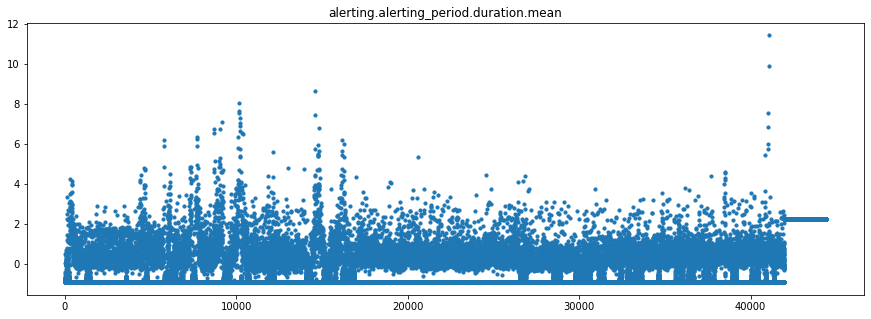

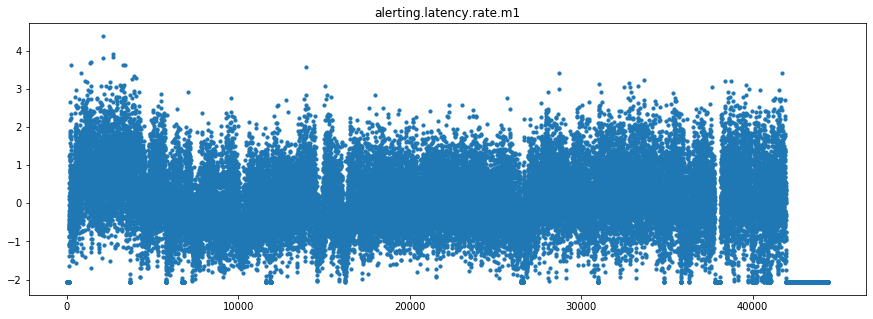

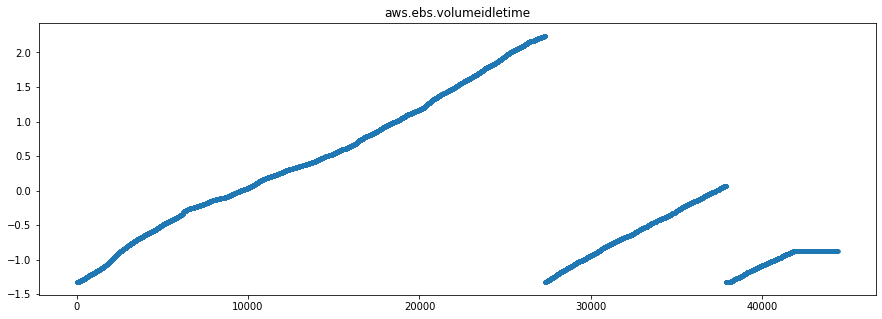

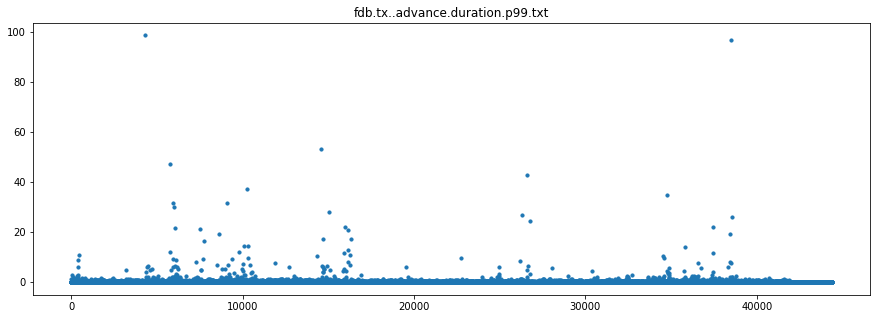

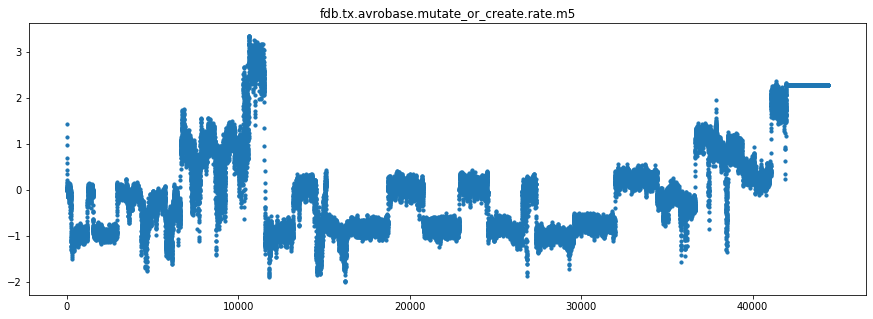

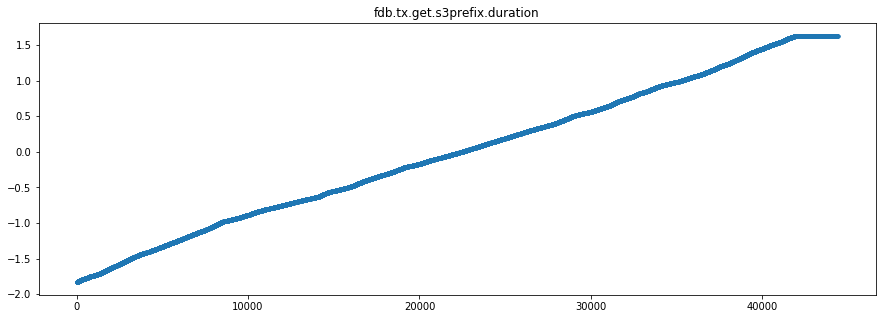

In [114]:
for j in [1, 50, 100, 500, 750, 1000]:
    plt.figure(figsize = (15,5))
    plt.scatter(np.arange(X[feature_names_real[j]].shape[0]), X[feature_names_real[j]], s = 10)
    plt.title(f"{feature_names[j]}")
    plt.show()

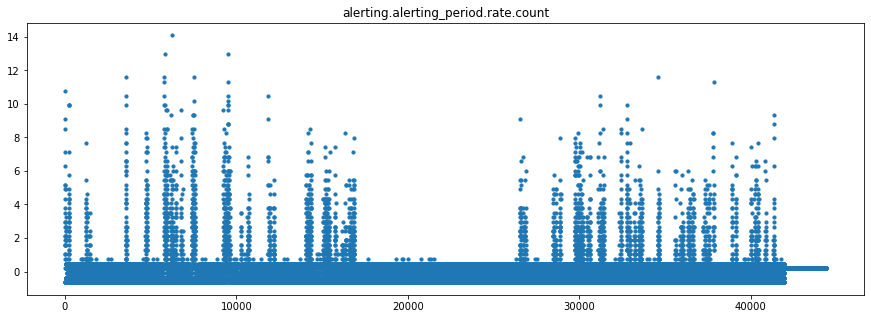

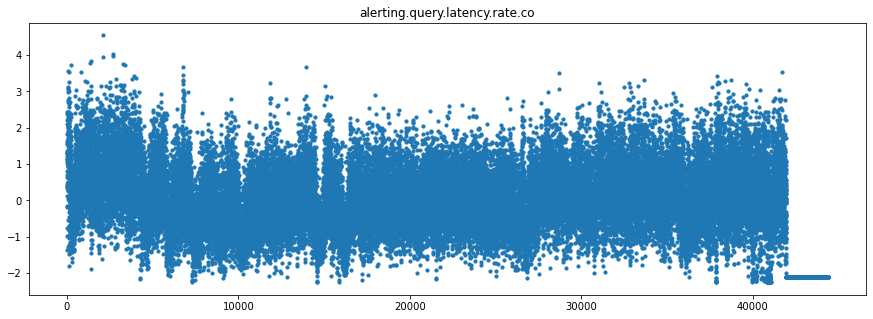

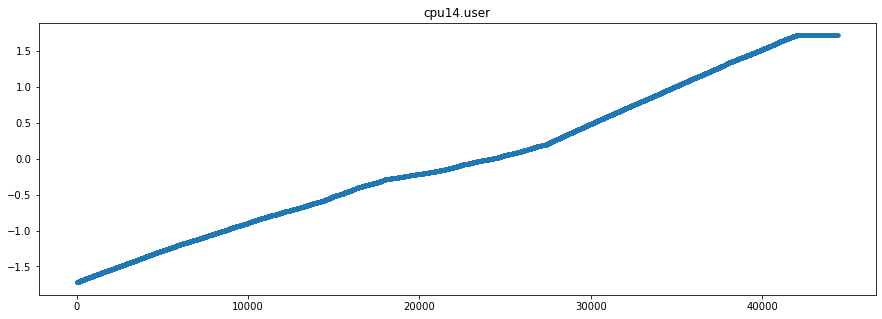

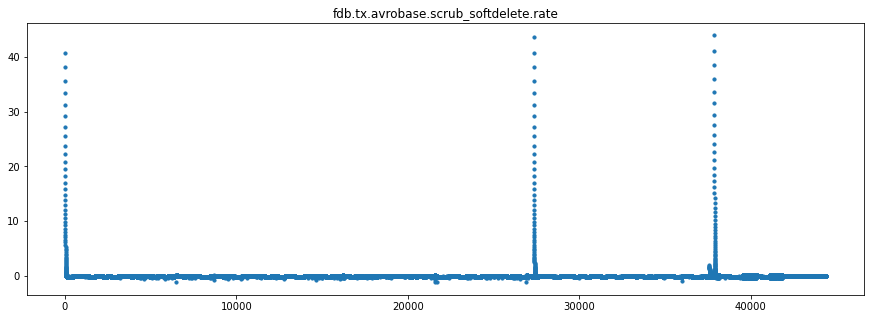

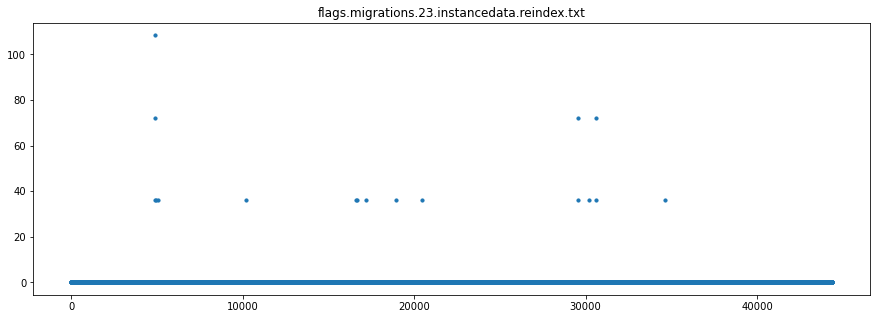

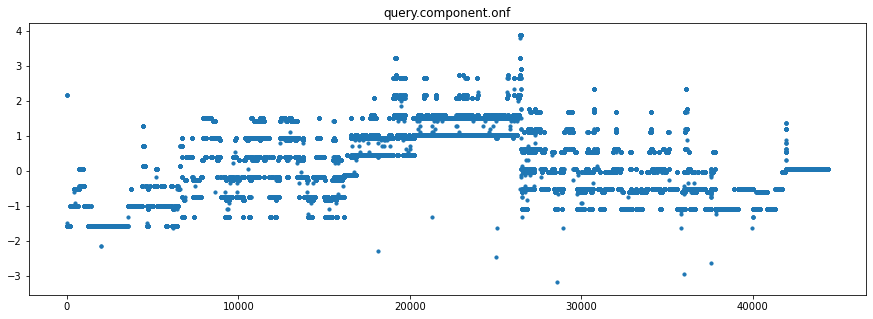

In [32]:
for j in [10, 70, 190, 800, 1100, 1289]:
    plt.figure(figsize = (15,5))
    plt.scatter(np.arange(X[feature_names_real[j]].shape[0]), X[feature_names_real[j]], s = 10)
    plt.title(f"{feature_names[j]}")
    plt.show()

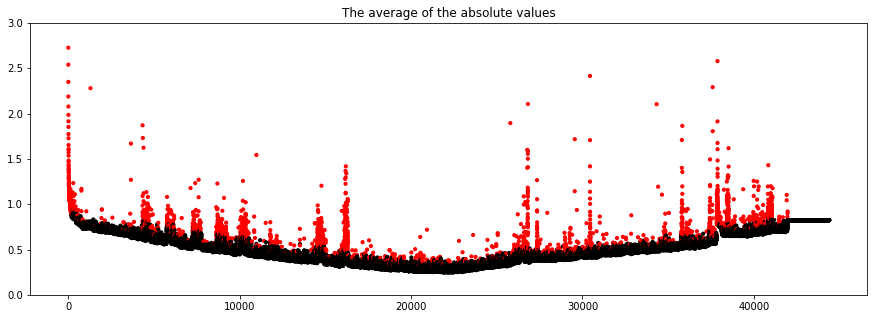

In [12]:
from matplotlib import cm
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
cmap = ListedColormap(["black", "red"])
plt.figure(figsize = (15,5))
plt.scatter(np.arange(len(y.values.flatten())), abs(X.values).mean(axis = 1), 
            c = y.values.flatten(), cmap = cmap, s = 10)
plt.ylim(0,3)
plt.title('The average of the absolute values')
plt.show()

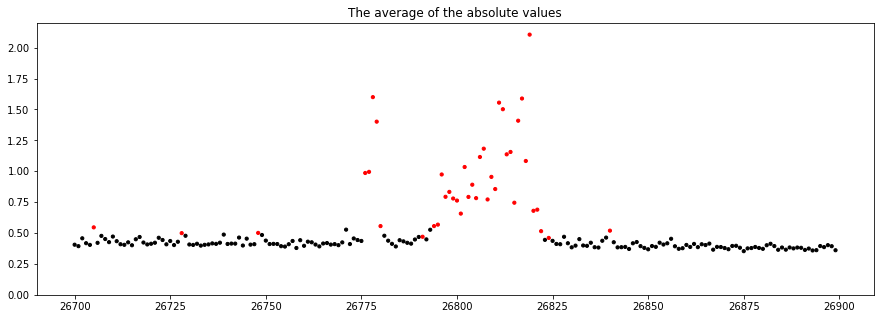

In [319]:
low = 26700
high = 26900
from matplotlib import cm
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
cmap = ListedColormap(["black", "red"])
plt.figure(figsize = (15,5))
plt.scatter(np.arange(len(y.values.flatten()))[low:high], abs(X.values).mean(axis = 1)[low:high], 
            c = y.values.flatten()[low:high], cmap = cmap, s = 10)
plt.ylim(0,2.2)
plt.title('The average of the absolute values')
plt.show()

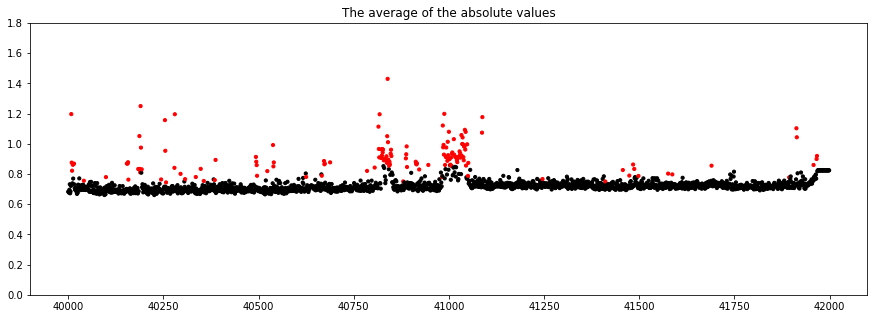

In [321]:
low = 40000
high = 42000
from matplotlib import cm
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
cmap = ListedColormap(["black", "red"])
plt.figure(figsize = (15,5))
plt.scatter(np.arange(len(y.values.flatten()))[low:high], abs(X.values).mean(axis = 1)[low:high], 
            c = y.values.flatten()[low:high], cmap = cmap, s = 10)
plt.ylim(0,1.8)
plt.title('The average of the absolute values')
plt.show()

# PCA

In [7]:
from sklearn.decomposition import PCA

In [8]:
model = PCA(n_components = 0.99, svd_solver = 'full')
model.fit(X)

PCA(n_components=0.99, svd_solver='full')

In [9]:
model.n_components_

298

# Clustering

In [13]:
from sklearn.metrics import pairwise_distances
from scipy.spatial.distance import cosine

dist_out = 1 - np.abs(X.corr())

In [14]:
dist_out

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V1281,V1282,V1283,V1284,V1285,V1286,V1287,V1288,V1289,V1290
V1,0.000000,0.071272,0.116306,0.228358,0.031290,0.000452,-2.220446e-16,-2.220446e-16,0.207527,0.086643,...,0.805460,0.998345,0.998345,0.999742,0.997050,0.980842,0.843132,0.911289,0.849710,0.989237
V2,0.071272,0.000000,0.010739,0.063027,0.035179,0.069399,7.127175e-02,7.127175e-02,0.436563,0.170484,...,0.832016,0.998749,0.998749,0.999517,0.991391,0.990102,0.834537,0.918376,0.872610,0.953451
V3,0.116306,0.010739,0.000000,0.059934,0.067353,0.114345,1.163059e-01,1.163059e-01,0.503300,0.204549,...,0.831124,0.998784,0.998784,0.999043,0.990219,0.992604,0.824860,0.912751,0.872687,0.951189
V4,0.228358,0.063027,0.059934,0.000000,0.178013,0.226484,2.283576e-01,2.283576e-01,0.743143,0.357640,...,0.909396,0.999436,0.999436,0.999475,0.990050,0.996226,0.869004,0.943983,0.936076,0.943354
V5,0.031290,0.035179,0.067353,0.178013,0.000000,0.029309,3.128957e-02,3.128957e-02,0.255560,0.111166,...,0.796374,0.998471,0.998471,0.999995,0.992238,0.980658,0.832366,0.916107,0.841544,0.954537
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
V1286,0.980842,0.990102,0.992604,0.996226,0.980658,0.980835,9.808421e-01,9.808421e-01,0.965977,0.966267,...,0.909087,0.999300,0.999300,0.999144,0.997275,0.000000,0.952656,0.962157,0.903890,0.962046
V1287,0.843132,0.834537,0.824860,0.869004,0.832366,0.843361,8.431316e-01,8.431316e-01,0.887013,0.836752,...,0.606714,0.992031,0.992031,0.991201,0.972084,0.952656,0.000000,0.630735,0.525668,0.704519
V1288,0.911289,0.918376,0.912751,0.943983,0.916107,0.911754,9.112886e-01,9.112886e-01,0.928891,0.910778,...,0.921476,0.996672,0.996672,0.999845,0.999070,0.962157,0.630735,0.000000,0.871188,0.402135
V1289,0.849710,0.872610,0.872687,0.936076,0.841544,0.848819,8.497103e-01,8.497103e-01,0.833179,0.807345,...,0.020589,0.994519,0.994519,0.993751,0.980160,0.903890,0.525668,0.871188,0.000000,0.938439


In [15]:
n = 381
from sklearn.cluster import AgglomerativeClustering
model = AgglomerativeClustering(affinity = 'precomputed', n_clusters = n, linkage = 'complete').fit(dist_out)
ind, c = np.unique(model.labels_,return_counts = True)

In [16]:
c

array([  2,   4,   2,   2,   3,   7,   2,   3,   6,   2,   2,   4,   3,
         7,   6,   2,  17,   3,   2,   2,   9,   2,   6,   3,   2,   3,
         9,  39,   4,   3,   3,   9,   4,   3,  21,   5,  48,   3,   4,
         4,   2,   2, 306,   2,   4,   3,   4,   4,   9,   8,   2,   1,
         4,  26,   2,   2,   2,   2,   3,   9,   8,   3,   2,   5,   7,
         2,   2,   2,   6,   2,  10,   7,   2,   3,  10,   3,   4,   3,
         5,   3,   2,   4,   2,   8,   2,   3,   2,  11,   2,   1,   5,
         2,   2,   3,   2,   2,  10,   1,   1,   2,  10,   1,   3,   1,
         1,   6,   2,   2,   2,   3,   1,   1,   2,   2,   1,   1,   1,
         4,   1,   1,   1,   1,   1,   1,   2,   1,   1,   1,   8,   2,
         3,   2,   1,   3,   6,   1,   1,   1,   3,   2,   3,   3,   4,
         1,   2,   1,   2,   2,   2,   1,   1,   1,   3,   1,   3,   2,
         1,   1,   1,   1,   2,   9,   1,   1,   2,   1,   3,   1,   9,
         4,   2,   3,   3,   1,   3,   1,   1,   1,   1,   1,   

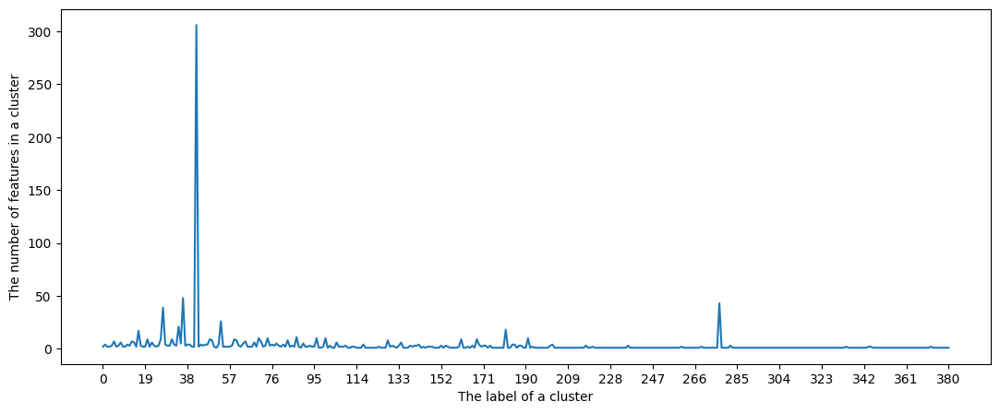

In [17]:
plt.figure(figsize = (13,5))
plt.ylabel('The number of features in a cluster')
plt.xlabel('The label of a cluster')
plt.xticks(np.arange(0,382,19))
plt.plot(c)
plt.show()

In [18]:
for n in np.arange(298,1029):
    from sklearn.cluster import AgglomerativeClustering
    model = AgglomerativeClustering(affinity = 'precomputed', n_clusters = n, linkage = 'complete').fit(dist_out)
    ind, c = np.unique(model.labels_,return_counts = True)
    bool = []
    for j in np.arange(n):
        bool.append(np.sum(np.sum(abs(X.iloc[:, model.labels_== j].corr()) > 0.8)) == c[j]**2) 
    print("n->", n, "   " , np.sum(bool))
    if np.sum(bool) == n:
        break

n-> 298     227
n-> 299     228
n-> 300     229
n-> 301     230
n-> 302     232
n-> 303     234
n-> 304     236
n-> 305     238
n-> 306     240
n-> 307     242
n-> 308     244
n-> 309     245
n-> 310     247
n-> 311     249
n-> 312     251
n-> 313     252
n-> 314     254
n-> 315     256
n-> 316     258
n-> 317     260
n-> 318     262
n-> 319     263
n-> 320     265
n-> 321     267
n-> 322     269
n-> 323     270
n-> 324     271
n-> 325     272
n-> 326     274
n-> 327     276
n-> 328     278
n-> 329     280
n-> 330     282
n-> 331     284
n-> 332     286
n-> 333     287
n-> 334     289
n-> 335     291
n-> 336     293
n-> 337     295
n-> 338     297
n-> 339     299
n-> 340     301
n-> 341     303
n-> 342     305
n-> 343     307
n-> 344     309
n-> 345     311
n-> 346     313
n-> 347     314
n-> 348     316
n-> 349     317
n-> 350     319
n-> 351     321
n-> 352     323
n-> 353     325
n-> 354     327
n-> 355     329
n-> 356     331
n-> 357     333
n-> 358     335
n-> 359     337
n-> 360 

In [19]:
nn = []
for j in np.arange(n):
    nn.append(X.iloc[:, model.labels_== j].columns[0])
len(nn)

381

In [20]:
X_new = X[nn]
X_new.shape

(44392, 381)

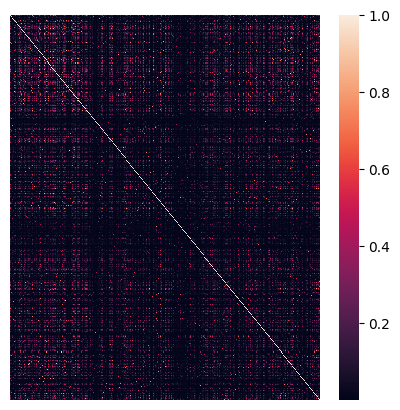

In [21]:
plt.figure(figsize = (5,5))
sns.heatmap(np.abs(X_new.corr()))
plt.tick_params(labelbottom = False, bottom=False, labelleft = False, left=False)

In [22]:
X_train, X_test, y_train, y_test = train_test_split(X_new, y, test_size = 0.4, random_state = 90)

In [16]:
mat = np.abs(X_new.corr()).values

In [17]:
corr_list = []
for j in np.arange(0,381):
    for i in np.arange(j+1, 381):
        corr_list.append(mat[j,i])

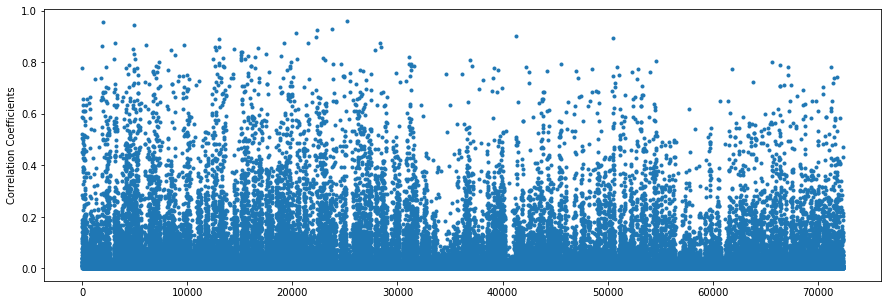

In [18]:
plt.figure(figsize = (15,5))
plt.ylabel('Correlation Coefficients')
plt.plot(corr_list,'.')

In [19]:
np.array(X_new.columns)

array(['V987', 'V1041', 'V910', 'V821', 'V924', 'V446', 'V856', 'V30',
       'V516', 'V532', 'V1059', 'V61', 'V781', 'V156', 'V477', 'V502',
       'V461', 'V489', 'V997', 'V1178', 'V889', 'V941', 'V50', 'V957',
       'V46', 'V40', 'V584', 'V98', 'V1031', 'V904', 'V430', 'V75',
       'V914', 'V60', 'V17', 'V505', 'V59', 'V478', 'V41', 'V810', 'V87',
       'V581', 'V106', 'V968', 'V447', 'V434', 'V853', 'V52', 'V599',
       'V158', 'V901', 'V1230', 'V748', 'V114', 'V1021', 'V1080', 'V539',
       'V906', 'V780', 'V522', 'V837', 'V550', 'V929', 'V785', 'V420',
       'V1248', 'V323', 'V852', 'V1', 'V504', 'V463', 'V583', 'V841',
       'V493', 'V548', 'V779', 'V844', 'V789', 'V507', 'V743', 'V537',
       'V555', 'V72', 'V459', 'V916', 'V421', 'V33', 'V460', 'V808',
       'V1277', 'V878', 'V1139', 'V1020', 'V538', 'V1278', 'V1002',
       'V628', 'V1114', 'V1087', 'V899', 'V585', 'V1135', 'V1035',
       'V1228', 'V1219', 'V1010', 'V1085', 'V11', 'V85', 'V819', 'V1067',
       'V10

# XGBoost

In [20]:
xgb = XGBClassifier()
n_estimators_grid = np.arange(200, 700, 100)
learning_rate_grid = [0.0001, 0.001, 0.01, 0.1, 0.5, 1, 2]
max_depth_grid = [1, 2, 3]
model_optimal_xgb = GridSearchCV(xgb, 
        param_grid = {'n_estimators': n_estimators_grid,
                     'learning_rate': learning_rate_grid,
                     'max_depth': max_depth_grid},
                     n_jobs = -1, verbose = 5, scoring = 'balanced_accuracy')
model_optimal_xgb.fit(X_train, y_train)

Fitting 5 folds for each of 105 candidates, totalling 525 fits


GridSearchCV(estimator=XGBClassifier(base_score=None, booster=None,
                                     callbacks=None, colsample_bylevel=None,
                                     colsample_bynode=None,
                                     colsample_bytree=None,
                                     early_stopping_rounds=None,
                                     enable_categorical=False, eval_metric=None,
                                     gamma=None, gpu_id=None, grow_policy=None,
                                     importance_type=None,
                                     interaction_constraints=None,
                                     learning_rate=None, max_bin=None,
                                     max_cat_to_...
                                     max_leaves=None, min_child_weight=None,
                                     missing=nan, monotone_constraints=None,
                                     n_estimators=100, n_jobs=None,
                                     n

In [21]:
model_optimal_xgb.best_params_

{'learning_rate': 0.5, 'max_depth': 1, 'n_estimators': 600}

In [22]:
model_final_xgb = model_optimal_xgb.best_estimator_

In [23]:
model_final_xgb.score(X_train, y_train)

0.9932795194293224

In [24]:
model_final_xgb.score( X_test, y_test)

0.9831615700850369

In [19]:
#pred_train = model_final_xgb.predict(X_train)
pred_train = xgb.predict(X_train)
print(classification_report(y_train, pred_train))

              precision    recall  f1-score   support

           0       0.99      1.00      1.00     25124
           1       0.99      0.89      0.94      1511

    accuracy                           0.99     26635
   macro avg       0.99      0.95      0.97     26635
weighted avg       0.99      0.99      0.99     26635



In [20]:
#pred_test = model_final_xgb.predict(X_test)
pred_test = xgb.predict(X_test)
print(classification_report(y_test, pred_test))

              precision    recall  f1-score   support

           0       0.99      0.99      0.99     16768
           1       0.90      0.79      0.84       989

    accuracy                           0.98     17757
   macro avg       0.94      0.89      0.91     17757
weighted avg       0.98      0.98      0.98     17757



In [18]:
params = {'learning_rate': 0.5, 'max_depth': 1, 'n_estimators': 600}
xgb = XGBClassifier()
xgb.set_params(**params)
xgb.fit(X_train, y_train)

XGBClassifier(base_score=0.5, booster='gbtree', callbacks=None,
              colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric=None, gamma=0, gpu_id=-1, grow_policy='depthwise',
              importance_type=None, interaction_constraints='',
              learning_rate=0.5, max_bin=256, max_cat_to_onehot=4,
              max_delta_step=0, max_depth=1, max_leaves=0, min_child_weight=1,
              missing=nan, monotone_constraints='()', n_estimators=600,
              n_jobs=0, num_parallel_tree=1, predictor='auto', random_state=0,
              reg_alpha=0, reg_lambda=1, ...)

In [27]:
from sklearn.metrics import PrecisionRecallDisplay

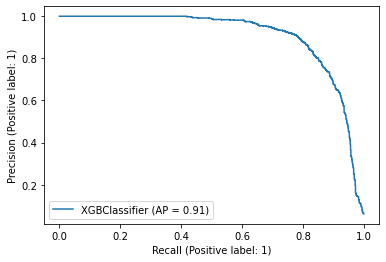

In [28]:
PrecisionRecallDisplay.from_estimator(xgb, X_test, y_test)

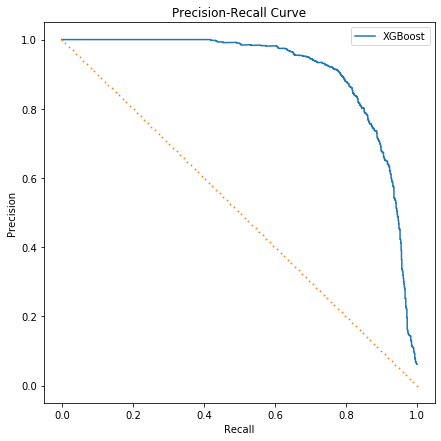

In [27]:
pred_prob = model_final_xgb.predict_proba(X_test)
precision, recall, thresholds = precision_recall_curve(y_true = y_test, 
                probas_pred = pred_prob[:,1], pos_label = 1)

x = np.linspace(0,1,100)
plt.figure(figsize = (7,7)) 
plt.plot(recall, precision, label = "XGBoost") 
plt.plot(x,-x +1, ".", markersize = 1.6) 
plt.title("Precision-Recall Curve")
plt.xlabel("Recall")
plt.ylabel("Precision")
plt.legend()
plt.show()

In [28]:
xgb = XGBClassifier()
params = {'learning_rate': 0.5, 'max_depth': 1, 'n_estimators': 600}
xgb.set_params(**params)
xgb.fit(X_new, y)

XGBClassifier(base_score=0.5, booster='gbtree', callbacks=None,
              colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric=None, gamma=0, gpu_id=-1, grow_policy='depthwise',
              importance_type=None, interaction_constraints='',
              learning_rate=0.5, max_bin=256, max_cat_to_onehot=4,
              max_delta_step=0, max_depth=1, max_leaves=0, min_child_weight=1,
              missing=nan, monotone_constraints='()', n_estimators=600,
              n_jobs=0, num_parallel_tree=1, predictor='auto', random_state=0,
              reg_alpha=0, reg_lambda=1, ...)

In [110]:
sorted(list(zip(X_new.columns, xgb.feature_importances_)), 
       key = lambda x: abs(x[1]), reverse = True)

[('V1080', 0.12573616),
 ('V599', 0.060241845),
 ('V539', 0.052330058),
 ('V1068', 0.05206635),
 ('V935', 0.043939084),
 ('V480', 0.034674656),
 ('V739', 0.028929248),
 ('V957', 0.025856225),
 ('V867', 0.023764636),
 ('V1085', 0.021908259),
 ('V21', 0.021787502),
 ('V1032', 0.017636845),
 ('V1232', 0.017525285),
 ('V916', 0.01751238),
 ('V575', 0.01578409),
 ('V767', 0.01440215),
 ('V808', 0.013714891),
 ('V418', 0.013028835),
 ('V41', 0.012549983),
 ('V1223', 0.010171309),
 ('V841', 0.009943929),
 ('V974', 0.009782977),
 ('V1007', 0.009410701),
 ('V583', 0.008896723),
 ('V17', 0.008428965),
 ('V905', 0.008401179),
 ('V87', 0.008085883),
 ('V880', 0.0080042975),
 ('V938', 0.0074851066),
 ('V962', 0.006763384),
 ('V1093', 0.006640637),
 ('V508', 0.0061998395),
 ('V522', 0.0057684896),
 ('V1010', 0.005702455),
 ('V492', 0.0056428714),
 ('V538', 0.005326878),
 ('V769', 0.0048594116),
 ('V33', 0.0047454895),
 ('V1133', 0.004741043),
 ('V420', 0.0045743273),
 ('V570', 0.0045041502),
 ('V889

In [29]:
imp = sorted(list(zip(X_new.columns, xgb.feature_importances_)), 
       key = lambda x: abs(x[1]), reverse = True)
names = []
scores = []
for j in np.arange(35):
    names.append(imp[j][0])
    scores.append(imp[j][1])

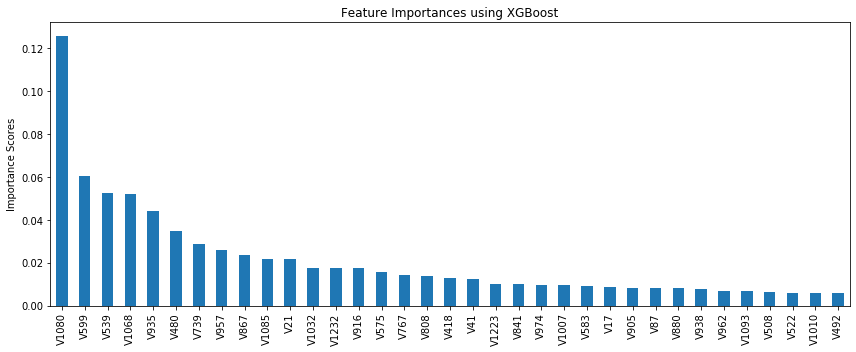

In [30]:
importances = scores
forest_importances = pd.Series(scores, index = names)

fig, ax = plt.subplots(figsize=(12,5))
forest_importances.plot.bar(ax=ax)
ax.set_title("Feature Importances using XGBoost")
ax.set_ylabel("Importance Scores")
fig.tight_layout()

In [113]:
result = permutation_importance(
   xgb, X_new, y, n_repeats = 5, random_state = 42, n_jobs = -1)

forest_importances = pd.Series(result.importances_mean, index = X_new.columns)

In [114]:
imp = sorted(list(zip(X_new.columns,result['importances_mean'])), key = lambda x: abs(x[1]), reverse = True)
names = []
scores = []
for j in np.arange(25):
    names.append(imp[j][0])
    scores.append(imp[j][1])

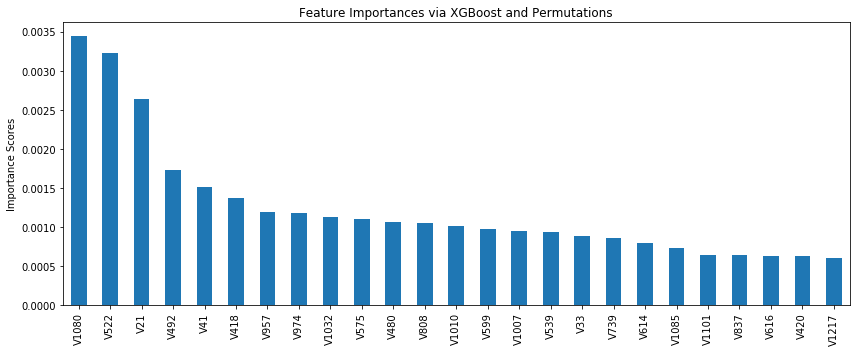

In [115]:
importances = scores
forest_importances = pd.Series(scores, index = names)

fig, ax = plt.subplots(figsize=(12,5))
forest_importances.plot.bar(ax=ax)
ax.set_title("Feature Importances via XGBoost and Permutations")
ax.set_ylabel("Importance Scores")
fig.tight_layout()

In [31]:
import lime 
from lime import lime_tabular

In [32]:
def pr(data):
    return np.array([[float(1-x), float(x)] for x in xgb.predict(data).ravel()])

In [155]:
explainer = lime.lime_tabular.LimeTabularExplainer(X_new.values, 
                                                   feature_names = X_new.columns,  
                                                   class_names = ['0','1'],
                                                   mode = 'classification')

In [156]:
index = 26810
exp = explainer.explain_instance(X_new.iloc[index,:], pr, num_features = 5, top_labels = 2)

In [157]:
np.round(xgb.predict(X_new))[index]

1

In [158]:
pr(X_new)[index]

array([0., 1.])

In [159]:
exp.as_list()

[('V1085 <= -0.01', -0.6405299981080964),
 ('V30 <= -0.01', -0.33022287441771486),
 ('V1232 > 0.03', 0.22122593913604546),
 ('V480 > -0.03', 0.1166633863738649),
 ('V957 > 0.02', 0.11611385003925766)]

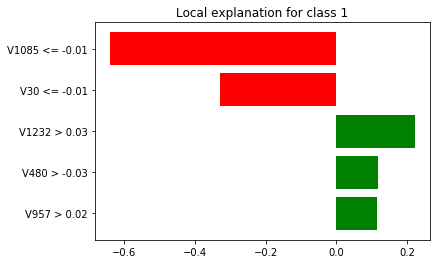

In [160]:
exp.as_pyplot_figure(label = 1);

In [161]:
feature_names[1084]

'fdb.tx.sldb.s3_to_ssd.rate.m1.txt'

In [162]:
feature_names[29]

'alerting.copy_alert_latency.duration.sum'

In [142]:
feature_names[1231]

'netstat.IpExt.InECT0Pkts.txt'

In [143]:
feature_names[479]

'events.rejected.txt'

In [144]:
feature_names[956]

'fdb.tx.dashboard.dashboard-default-rein'

In [163]:
exp.show_in_notebook(labels = [1])

In [166]:
import shap

In [289]:
dd = X_new.loc[y == 1,:]

In [290]:
dd.shape

(2500, 381)

In [204]:
explainer = shap.Explainer(xgb.predict, dd.iloc[2000:2500,:])
shap_values = explainer(dd.iloc[2000:2500,:], max_evals = 50000)





Permutation explainer:   0%|          | 1/500 [00:00<?, ?it/s]



Permutation explainer:   1%|          | 3/500 [00:46<1:35:22, 11.51s/it]



Permutation explainer:   1%|          | 4/500 [01:10<2:03:59, 15.00s/it]



Permutation explainer:   1%|          | 5/500 [01:32<2:22:59, 17.33s/it]



Permutation explainer:   1%|          | 6/500 [01:54<2:33:17, 18.62s/it]



Permutation explainer:   1%|▏         | 7/500 [02:15<2:39:27, 19.41s/it]



Permutation explainer:   2%|▏         | 8/500 [02:37<2:44:03, 20.01s/it]



Permutation explainer:   2%|▏         | 9/500 [02:59<2:49:02, 20.66s/it]



Permutation explainer:   2%|▏         | 10/500 [03:20<2:51:11, 20.96s/it]



Permutation explainer:   2%|▏         | 11/500 [03:43<2:55:32, 21.54s/it]



Permutation explainer:   2%|▏         | 12/500 [04:06<2:57:28, 21.82s/it]



Permutation explainer:   3%|▎         | 13/500 [04:27<2:56:39, 21.76s/it]



Permutation explainer:   3%|▎         | 14/500 [04:49<2:56:31, 21.79s/it]



Permutation e

Permutation explainer:  37%|███▋      | 184/500 [1:03:39<1:45:49, 20.09s/it]



Permutation explainer:  37%|███▋      | 185/500 [1:03:59<1:45:14, 20.05s/it]



Permutation explainer:  37%|███▋      | 186/500 [1:04:19<1:45:24, 20.14s/it]



Permutation explainer:  37%|███▋      | 187/500 [1:04:40<1:46:16, 20.37s/it]



Permutation explainer:  38%|███▊      | 188/500 [1:05:00<1:45:35, 20.31s/it]



Permutation explainer:  38%|███▊      | 189/500 [1:05:21<1:45:39, 20.38s/it]



Permutation explainer:  38%|███▊      | 190/500 [1:05:41<1:45:04, 20.34s/it]



Permutation explainer:  38%|███▊      | 191/500 [1:06:02<1:45:02, 20.40s/it]



Permutation explainer:  38%|███▊      | 192/500 [1:06:22<1:45:10, 20.49s/it]



Permutation explainer:  39%|███▊      | 193/500 [1:06:43<1:44:40, 20.46s/it]



Permutation explainer:  39%|███▉      | 194/500 [1:07:04<1:44:59, 20.59s/it]



Permutation explainer:  39%|███▉      | 195/500 [1:07:24<1:44:34, 20.57s/it]



Permutation explainer:  39%|███▉      | 

Permutation explainer:  72%|███████▏  | 362/500 [2:06:47<49:10, 21.38s/it]



Permutation explainer:  73%|███████▎  | 363/500 [2:07:08<48:20, 21.17s/it]



Permutation explainer:  73%|███████▎  | 364/500 [2:07:29<47:44, 21.06s/it]



Permutation explainer:  73%|███████▎  | 365/500 [2:07:50<47:19, 21.03s/it]



Permutation explainer:  73%|███████▎  | 366/500 [2:08:11<46:44, 20.93s/it]



Permutation explainer:  73%|███████▎  | 367/500 [2:08:32<46:25, 20.95s/it]



Permutation explainer:  74%|███████▎  | 368/500 [2:08:52<46:04, 20.95s/it]



Permutation explainer:  74%|███████▍  | 369/500 [2:09:13<45:31, 20.85s/it]



Permutation explainer:  74%|███████▍  | 370/500 [2:09:35<45:58, 21.22s/it]



Permutation explainer:  74%|███████▍  | 371/500 [2:09:56<45:31, 21.17s/it]



Permutation explainer:  74%|███████▍  | 372/500 [2:10:17<44:49, 21.01s/it]



Permutation explainer:  75%|███████▍  | 373/500 [2:10:39<45:03, 21.29s/it]



Permutation explainer:  75%|███████▍  | 374/500 [2:10:59<44:07, 

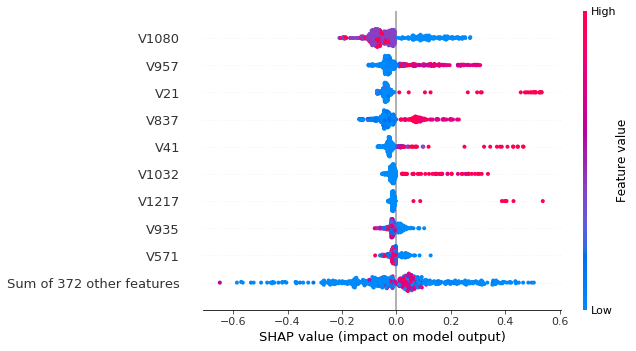

In [205]:
shap.plots.beeswarm(shap_values)

In [206]:
shap_values

.values =
array([[ 0.00038961,  0.        ,  0.00032468, ...,  0.        ,
         0.        , -0.00097403],
       [ 0.00051948,  0.        ,  0.00071429, ...,  0.        ,
         0.        , -0.00298701],
       [ 0.00149351,  0.        ,  0.00227273, ...,  0.        ,
         0.        , -0.00415584],
       ...,
       [ 0.00071429,  0.        ,  0.00103896, ...,  0.        ,
         0.        , -0.00181818],
       [ 0.00097403,  0.        ,  0.00058442, ...,  0.        ,
         0.        , -0.00136364],
       [ 0.00019481,  0.        ,  0.00032468, ...,  0.        ,
         0.        , -0.00064935]])

.base_values =
array([0.99, 0.99, 0.99, 0.99, 0.99, 0.99, 0.99, 0.99, 0.99, 0.99, 0.99,
       0.99, 0.99, 0.99, 0.99, 0.99, 0.99, 0.99, 0.99, 0.99, 0.99, 0.99,
       0.99, 0.99, 0.99, 0.99, 0.99, 0.99, 0.99, 0.99, 0.99, 0.99, 0.99,
       0.99, 0.99, 0.99, 0.99, 0.99, 0.99, 0.99, 0.99, 0.99, 0.99, 0.99,
       0.99, 0.99, 0.99, 0.99, 0.99, 0.99, 0.99, 0.99, 0.99, 0.99, 0.

In [207]:
shap.initjs()

In [210]:
shap.force_plot(0.99, shap_values.values, shap_values.data, figsize=(1, 5))

# AdaBoostClassifier

In [87]:
ada = AdaBoostClassifier()
n_estimators_grid = np.arange(200, 700, 100)
learning_rate_grid = [0.0001, 0.001, 0.01, 0.1, 0.5, 1, 2]
model_optimal_ada = GridSearchCV(ada, 
        param_grid = {'n_estimators': n_estimators_grid,
                     'learning_rate': learning_rate_grid},
                     n_jobs = -1, verbose = 5, scoring = 'balanced_accuracy')
model_optimal_ada.fit(X_train, y_train)

Fitting 5 folds for each of 35 candidates, totalling 175 fits


GridSearchCV(estimator=AdaBoostClassifier(), n_jobs=-1,
             param_grid={'learning_rate': [0.0001, 0.001, 0.01, 0.1, 0.5, 1, 2],
                         'n_estimators': array([200, 300, 400, 500, 600])},
             scoring='balanced_accuracy', verbose=5)

In [88]:
model_optimal_ada.best_params_

{'learning_rate': 0.5, 'n_estimators': 600}

In [89]:
model_final_ada = model_optimal_ada.best_estimator_

In [90]:
model_final_ada.score(X_train, y_train)

0.9979725924535385

In [91]:
model_final_ada.score(X_test, y_test)

0.9874415723376696

In [16]:
#pred_train = model_final_ada.predict(X_train)
pred_train = ada.predict(X_train)
print(classification_report(y_train, pred_train))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     25124
           1       1.00      0.97      0.99      1511

    accuracy                           1.00     26635
   macro avg       1.00      0.99      0.99     26635
weighted avg       1.00      1.00      1.00     26635



In [17]:
#pred_test = model_final_ada.predict(X_test)
pred_test = ada.predict(X_test)
print(classification_report(y_test, pred_test))

              precision    recall  f1-score   support

           0       0.99      0.99      0.99     16768
           1       0.90      0.85      0.88       989

    accuracy                           0.99     17757
   macro avg       0.95      0.92      0.93     17757
weighted avg       0.99      0.99      0.99     17757



In [14]:
ada = AdaBoostClassifier()
params = {'learning_rate': 0.5, 'n_estimators': 600}
ada.set_params(**params)
ada.fit(X_train, y_train)

AdaBoostClassifier(learning_rate=0.5, n_estimators=600)

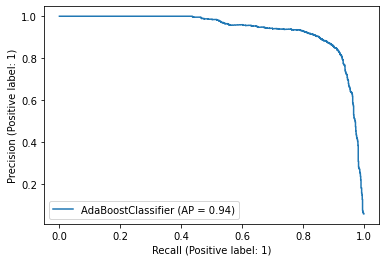

In [32]:
PrecisionRecallDisplay.from_estimator(ada, X_test, y_test)

In [34]:
pred_train = ada.predict(X_train)
print(classification_report(y_train, pred_train))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     25124
           1       1.00      0.97      0.99      1511

    accuracy                           1.00     26635
   macro avg       1.00      0.99      0.99     26635
weighted avg       1.00      1.00      1.00     26635



In [35]:
pred_test = ada.predict(X_test)
print(classification_report(y_test, pred_test))

              precision    recall  f1-score   support

           0       0.99      0.99      0.99     16768
           1       0.90      0.85      0.88       989

    accuracy                           0.99     17757
   macro avg       0.95      0.92      0.93     17757
weighted avg       0.99      0.99      0.99     17757



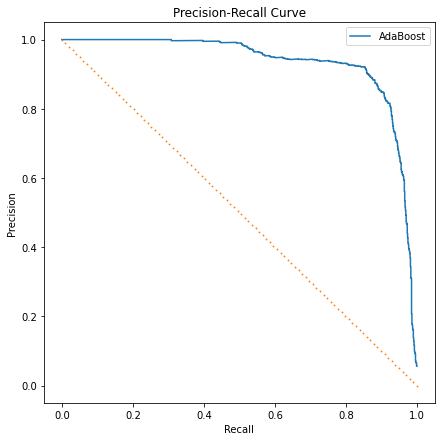

In [94]:
pred_prob = model_final_ada.predict_proba(X_test)
precision, recall, thresholds = precision_recall_curve(y_true = y_test, 
                probas_pred = pred_prob[:,1], pos_label = 1)

x = np.linspace(0,1,100)
plt.figure(figsize = (7,7)) 
plt.plot(recall, precision, label = "AdaBoost") 
plt.plot(x,-x +1, ".", markersize = 1.6) 
plt.title("Precision-Recall Curve")
plt.xlabel("Recall")
plt.ylabel("Precision")
plt.legend()
plt.show()

In [211]:
ada = AdaBoostClassifier()
params = {'learning_rate': 0.5, 'n_estimators': 600}
ada.set_params(**params)
ada.fit(X_new, y)

AdaBoostClassifier(learning_rate=0.5, n_estimators=600)

In [212]:
imp = sorted(list(zip(X_new.columns, ada.feature_importances_)), 
       key = lambda x: abs(x[1]), reverse = True)
names = []
scores = []
for j in np.arange(35):
    names.append(imp[j][0])
    scores.append(imp[j][1])

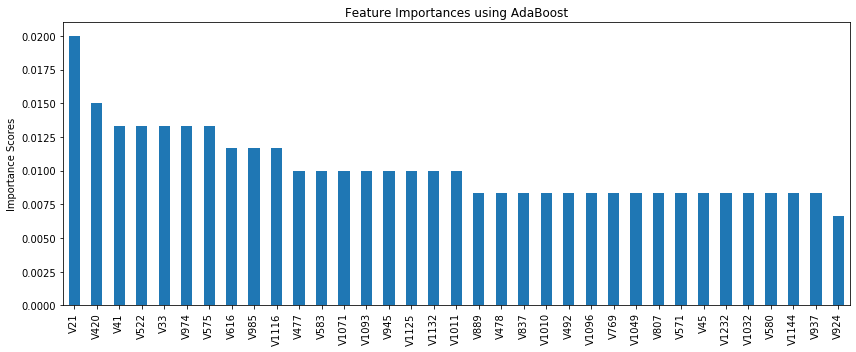

In [213]:
importances = scores
forest_importances = pd.Series(scores, index = names)

fig, ax = plt.subplots(figsize=(12,5))
forest_importances.plot.bar(ax=ax)
ax.set_title("Feature Importances using AdaBoost")
ax.set_ylabel("Importance Scores")
fig.tight_layout()

In [215]:
result = permutation_importance(
   ada, X_new, y, n_repeats = 5, random_state = 42, n_jobs = -1)

In [216]:
imp = sorted(list(zip(X_new.columns, result['importances_mean'])), key = lambda x: abs(x[1]), reverse = True)
names = []
scores = []
for j in np.arange(25):
    names.append(imp[j][0])
    scores.append(imp[j][1])

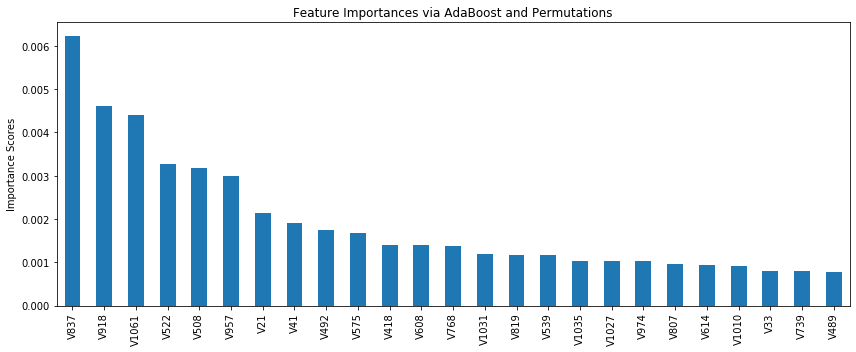

In [217]:
importances = scores
forest_importances = pd.Series(scores, index = names)

fig, ax = plt.subplots(figsize=(12,5))
forest_importances.plot.bar(ax=ax)
ax.set_title("Feature Importances via AdaBoost and Permutations")
ax.set_ylabel("Importance Scores")
fig.tight_layout()

In [228]:
def pr(data):
    return np.array([[float(1-x), float(x)] for x in ada.predict(data).ravel()])

In [230]:
explainer = lime.lime_tabular.LimeTabularExplainer(X_new.values, 
                                                   feature_names = X_new.columns,  
                                                   class_names = ['0','1'],
                                                   mode = 'classification')

In [246]:
index = 26810
exp = explainer.explain_instance(X_new.iloc[index,:], pr, num_features = 6, top_labels = 2)

X does not have valid feature names, but AdaBoostClassifier was fitted with feature names


In [247]:
exp.as_list()

[('V435 <= -0.02', -0.7824941361599689),
 ('V1035 <= -0.02', -0.7148809884193171),
 ('V1068 <= -0.02', -0.3546379485747304),
 ('V30 <= -0.01', -0.161948515791574),
 ('V1232 > 0.03', 0.12612121203157894),
 ('V446 <= -0.04', -0.07226127733986859)]

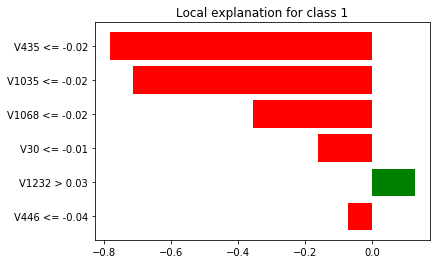

In [248]:
exp.as_pyplot_figure(label = 1);

In [249]:
exp.show_in_notebook(labels = [1])

In [291]:
dd = X_new.loc[y == 1,:]
dd.shape

(2500, 381)

In [259]:
explainer = shap.Explainer(ada.predict, dd.iloc[2480:2500,:], njobs = -1)

In [261]:
shap_values = explainer(dd.iloc[2480:2500,:], max_evals = 50000)







Permutation explainer:   5%|▌         | 1/20 [00:00<?, ?it/s]





Permutation explainer:  15%|█▌        | 3/20 [13:34<57:21, 202.46s/it]





Permutation explainer:  20%|██        | 4/20 [20:10<1:09:29, 260.57s/it]





Permutation explainer:  25%|██▌       | 5/20 [26:52<1:15:44, 302.95s/it]





Permutation explainer:  30%|███       | 6/20 [33:23<1:16:53, 329.50s/it]





Permutation explainer:  35%|███▌      | 7/20 [40:12<1:16:31, 353.20s/it]





Permutation explainer:  40%|████      | 8/20 [46:59<1:13:51, 369.27s/it]





Permutation explainer:  45%|████▌     | 9/20 [53:42<1:09:33, 379.45s/it]





Permutation explainer:  50%|█████     | 10/20 [1:00:20<1:04:11, 385.17s/it]





Permutation explainer:  55%|█████▌    | 11/20 [1:07:27<59:37, 397.50s/it]  





Permutation explainer:  60%|██████    | 12/20 [1:13:58<52:44, 395.58s/it]





Permutation explainer:  65%|██████▌   | 13/20 [1:20:42<46:28, 398.29s/it]





Permutation explainer:  70%|███████   | 14/20 [1:27:21<39:49, 3

In [262]:
shap_values

.values =
array([[ 0.        ,  0.        ,  0.        , ...,  0.        ,
         0.        ,  0.01337209],
       [ 0.        ,  0.        ,  0.        , ...,  0.        ,
         0.        ,  0.01453488],
       [ 0.        ,  0.        ,  0.        , ...,  0.        ,
         0.        ,  0.00145349],
       ...,
       [ 0.        ,  0.        ,  0.        , ...,  0.        ,
         0.        ,  0.00552326],
       [ 0.        ,  0.        ,  0.        , ...,  0.        ,
         0.        , -0.01656977],
       [ 0.        ,  0.        ,  0.        , ...,  0.        ,
         0.        , -0.01482558]])

.base_values =
array([0.9, 0.9, 0.9, 0.9, 0.9, 0.9, 0.9, 0.9, 0.9, 0.9, 0.9, 0.9, 0.9,
       0.9, 0.9, 0.9, 0.9, 0.9, 0.9, 0.9])

.data =
array([[-1.27520068, -0.03290018, -0.06596916, ..., -0.42698507,
         1.27873318,  0.38682977],
       [-1.27525808, -0.03290018,  0.08129571, ..., -0.42881099,
         1.27873318,  0.8522268 ],
       [-1.27158448, -0.03290018,  3.

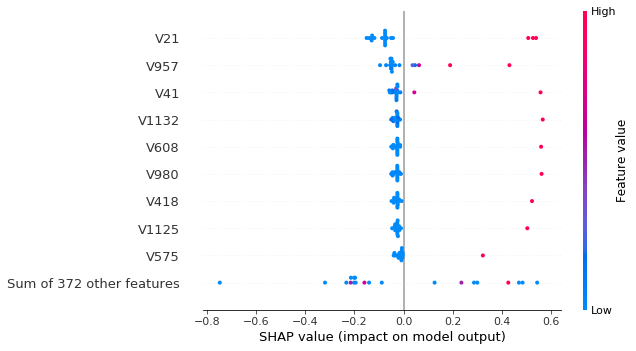

In [263]:
shap.plots.beeswarm(shap_values)

In [264]:
shap.force_plot(0.9, shap_values.values, shap_values.data, figsize=(1, 5))

# Neural Network

In [23]:
from keras.models import Sequential
from keras.layers import Dense, Flatten
from keras.wrappers.scikit_learn import KerasClassifier
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import StratifiedKFold
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from keras import regularizers
from keras.layers import Dense, Dropout

In [24]:
from sklearn.neural_network import MLPClassifier

In [25]:
np.unique(y_train,return_counts = True)

(array([0, 1], dtype=int64), array([25124,  1511], dtype=int64))

In [26]:
len(y_train)

26635

In [27]:
n = X_train.shape[1]

In [28]:
#min_max_scaler = MinMaxScaler()
#x_train = min_max_scaler.fit_transform(X_train)
#x_test = min_max_scaler.fit_transform(X_test)

model = Sequential()
model.add(Dense(32, activation='relu', input_shape=(n,), 
          kernel_regularizer=regularizers.L1L2(l1=1e-3, l2=1e-2),
          bias_regularizer=regularizers.L2(1e-2),
          activity_regularizer=regularizers.L2(1e-3)))
model.add(Dense(16, activation='relu',
         kernel_regularizer=regularizers.L1L2(l1=1e-3, l2=1e-2),
         bias_regularizer=regularizers.L2(1e-2),
         activity_regularizer=regularizers.L2(1e-3)))
model.add(Dense(1, activation='sigmoid'))
print(model.summary())
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])


history = model.fit(X_train, y_train, epochs = 1000, 
                    validation_data=(X_test, y_test), batch_size = 2048)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 32)                12224     
                                                                 
 dense_1 (Dense)             (None, 16)                528       
                                                                 
 dense_2 (Dense)             (None, 1)                 17        
                                                                 
Total params: 12,769
Trainable params: 12,769
Non-trainable params: 0
_________________________________________________________________
None
Epoch 1/1000
14/14 [==============================] - 2s 49ms/step - loss: 2.3017 - accuracy: 0.5283 - val_loss: 1.9200 - val_accuracy: 0.8693
Epoch 2/1000
14/14 [==============================] - 0s 22ms/step - loss: 1.7362 - accuracy: 0.9280 - val_loss: 1.5354 - val_accuracy: 0.9587
Epoch 3/1000
14/14 [=====

14/14 [==============================] - 0s 22ms/step - loss: 0.1349 - accuracy: 0.9843 - val_loss: 0.1371 - val_accuracy: 0.9838
Epoch 53/1000
14/14 [==============================] - 0s 22ms/step - loss: 0.1318 - accuracy: 0.9861 - val_loss: 0.1358 - val_accuracy: 0.9854
Epoch 54/1000
14/14 [==============================] - 0s 22ms/step - loss: 0.1287 - accuracy: 0.9868 - val_loss: 0.1331 - val_accuracy: 0.9846
Epoch 55/1000
14/14 [==============================] - 0s 22ms/step - loss: 0.1280 - accuracy: 0.9855 - val_loss: 0.1324 - val_accuracy: 0.9851
Epoch 56/1000
14/14 [==============================] - 0s 22ms/step - loss: 0.1254 - accuracy: 0.9871 - val_loss: 0.1301 - val_accuracy: 0.9854
Epoch 57/1000
14/14 [==============================] - 0s 21ms/step - loss: 0.1234 - accuracy: 0.9867 - val_loss: 0.1282 - val_accuracy: 0.9857
Epoch 58/1000
14/14 [==============================] - 0s 22ms/step - loss: 0.1220 - accuracy: 0.9872 - val_loss: 0.1269 - val_accuracy: 0.9851
Epoch 

Epoch 109/1000
14/14 [==============================] - 0s 22ms/step - loss: 0.0904 - accuracy: 0.9875 - val_loss: 0.0961 - val_accuracy: 0.9872
Epoch 110/1000
14/14 [==============================] - 0s 22ms/step - loss: 0.0891 - accuracy: 0.9884 - val_loss: 0.0952 - val_accuracy: 0.9876
Epoch 111/1000
14/14 [==============================] - 0s 22ms/step - loss: 0.0884 - accuracy: 0.9883 - val_loss: 0.0955 - val_accuracy: 0.9876
Epoch 112/1000
14/14 [==============================] - 0s 22ms/step - loss: 0.0956 - accuracy: 0.9866 - val_loss: 0.1044 - val_accuracy: 0.9845
Epoch 113/1000
14/14 [==============================] - 0s 22ms/step - loss: 0.0969 - accuracy: 0.9853 - val_loss: 0.1001 - val_accuracy: 0.9851
Epoch 114/1000
14/14 [==============================] - 0s 22ms/step - loss: 0.0923 - accuracy: 0.9877 - val_loss: 0.0979 - val_accuracy: 0.9861
Epoch 115/1000
14/14 [==============================] - 0s 22ms/step - loss: 0.0912 - accuracy: 0.9883 - val_loss: 0.0980 - val_ac

14/14 [==============================] - 0s 25ms/step - loss: 0.0769 - accuracy: 0.9884 - val_loss: 0.0834 - val_accuracy: 0.9868
Epoch 166/1000
14/14 [==============================] - 0s 22ms/step - loss: 0.0759 - accuracy: 0.9884 - val_loss: 0.0827 - val_accuracy: 0.9868
Epoch 167/1000
14/14 [==============================] - 0s 23ms/step - loss: 0.0752 - accuracy: 0.9889 - val_loss: 0.0821 - val_accuracy: 0.9870
Epoch 168/1000
14/14 [==============================] - 0s 25ms/step - loss: 0.0747 - accuracy: 0.9890 - val_loss: 0.0816 - val_accuracy: 0.9871
Epoch 169/1000
14/14 [==============================] - 0s 24ms/step - loss: 0.0746 - accuracy: 0.9888 - val_loss: 0.0818 - val_accuracy: 0.9869
Epoch 170/1000
14/14 [==============================] - 0s 23ms/step - loss: 0.0745 - accuracy: 0.9888 - val_loss: 0.0811 - val_accuracy: 0.9872
Epoch 171/1000
14/14 [==============================] - 0s 23ms/step - loss: 0.0738 - accuracy: 0.9889 - val_loss: 0.0808 - val_accuracy: 0.9873


14/14 [==============================] - 0s 31ms/step - loss: 0.0728 - accuracy: 0.9864 - val_loss: 0.0774 - val_accuracy: 0.9854
Epoch 222/1000
14/14 [==============================] - 0s 22ms/step - loss: 0.0686 - accuracy: 0.9881 - val_loss: 0.0741 - val_accuracy: 0.9858
Epoch 223/1000
14/14 [==============================] - 0s 22ms/step - loss: 0.0671 - accuracy: 0.9885 - val_loss: 0.0732 - val_accuracy: 0.9865
Epoch 224/1000
14/14 [==============================] - 0s 22ms/step - loss: 0.0665 - accuracy: 0.9883 - val_loss: 0.0731 - val_accuracy: 0.9866
Epoch 225/1000
14/14 [==============================] - 0s 22ms/step - loss: 0.0658 - accuracy: 0.9888 - val_loss: 0.0728 - val_accuracy: 0.9868
Epoch 226/1000
14/14 [==============================] - 0s 23ms/step - loss: 0.0650 - accuracy: 0.9893 - val_loss: 0.0720 - val_accuracy: 0.9876
Epoch 227/1000
14/14 [==============================] - 0s 22ms/step - loss: 0.0646 - accuracy: 0.9894 - val_loss: 0.0716 - val_accuracy: 0.9878


KeyboardInterrupt: 

In [46]:
len(model.get_weights()[0][:,0])

381

dict_keys(['loss', 'accuracy', 'val_loss', 'val_accuracy'])


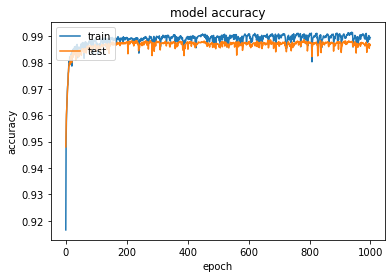

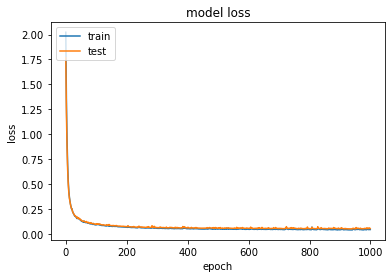

In [37]:
print(history.history.keys())
# summarize history for accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()
# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

In [38]:
pred_train = np.round(model.predict(X_train))
print(classification_report(y_train, pred_train))

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
              precision    recall  f1-score   support

           0       0.99      1.00      0.99     25124
           1       0.93      0.88      0.91      1511

    accuracy                           0.99     26635
   macro avg       0.96      0.94      0.95     26635
weighted avg       0.99      0.99      0.99     26635



In [39]:
pred_test = np.round(model.predict(X_test))
print(classification_report(y_test, pred_test))

              precision    recall  f1-score   support

           0       0.99      0.99      0.99     16768
           1       0.90      0.85      0.88       989

    accuracy                           0.99     17757
   macro avg       0.95      0.92      0.93     17757
weighted avg       0.99      0.99      0.99     17757



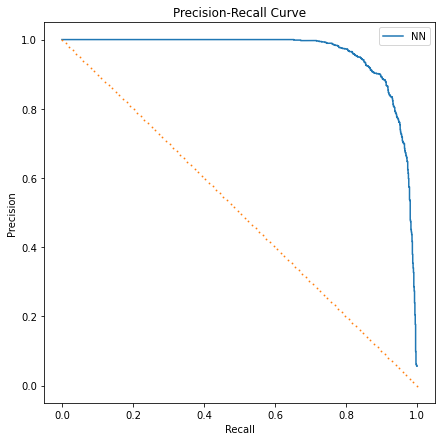

In [26]:
pred_prob = model.predict(X_test)
precision, recall, thresholds = precision_recall_curve(y_true = y_test, 
                probas_pred = pred_prob[:,0], pos_label = 1)

x = np.linspace(0,1,100)
plt.figure(figsize = (7,7)) 
plt.plot(recall, precision, label = "NN") 
plt.plot(x,-x +1, ".", markersize = 1.6) 
plt.title("Precision-Recall Curve")
plt.xlabel("Recall")
plt.ylabel("Precision")
plt.legend()
plt.show()

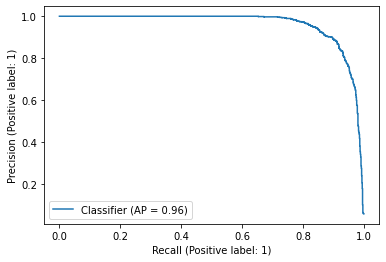

In [27]:
PrecisionRecallDisplay.from_predictions(y_test, model.predict(X_test))

In [57]:
model = MLPClassifier(hidden_layer_sizes = (8,4), early_stopping = True, learning_rate = 'adaptive')
model.fit(X_train.values, y_train.values)

MLPClassifier(early_stopping=True, hidden_layer_sizes=(8, 4),
              learning_rate='adaptive')

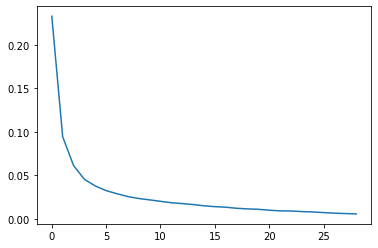

In [60]:
plt.plot(model.loss_curve_)

In [61]:
pred_train = np.round(model_optimal.predict(X_train.values))
print(classification_report(y_train.values, pred_train))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     25124
           1       0.97      0.96      0.96      1511

    accuracy                           1.00     26635
   macro avg       0.98      0.98      0.98     26635
weighted avg       1.00      1.00      1.00     26635



In [62]:
pred_test = np.round(model_optimal.predict(X_test.values))
print(classification_report(y_test.values, pred_test))

              precision    recall  f1-score   support

           0       0.99      0.99      0.99     16768
           1       0.90      0.86      0.88       989

    accuracy                           0.99     17757
   macro avg       0.94      0.93      0.94     17757
weighted avg       0.99      0.99      0.99     17757



X has feature names, but MLPClassifier was fitted without feature names


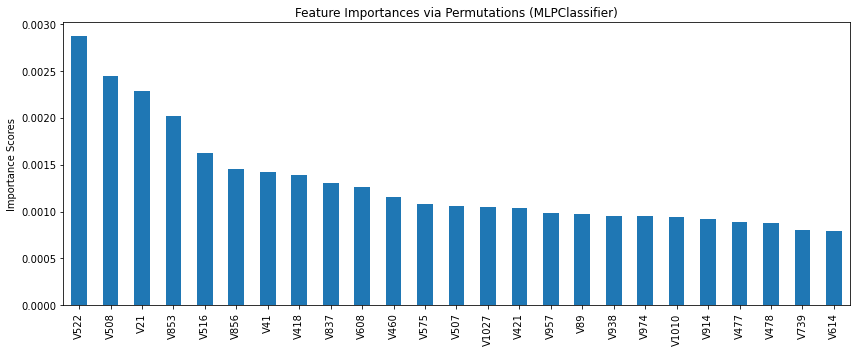

In [63]:
result = permutation_importance(
   model, X_new, y, n_repeats = 20, random_state = 42, n_jobs = -1)

forest_importances = pd.Series(result.importances_mean, index = X_new.columns)

imp = sorted(list(zip(X_new.columns,result['importances_mean'])), key = lambda x: abs(x[1]), reverse = True)
names = []
scores = []
for j in np.arange(25):
    names.append(imp[j][0])
    scores.append(imp[j][1])

importances = scores
forest_importances = pd.Series(scores, index = names)

fig, ax = plt.subplots(figsize = (12,5))
forest_importances.plot.bar(ax=ax)
ax.set_title("Feature Importances via Permutations (MLPClassifier)")
ax.set_ylabel("Importance Scores")
fig.tight_layout()

In [28]:
def pr(data):
    return np.array([[float(1-x), float(x)] for x in model.predict(data).ravel()])

In [29]:
explainer = lime.lime_tabular.LimeTabularExplainer(X_new.values, 
                                                   feature_names = X_new.columns,  
                                                   class_names = ['0','1'],
                                                   mode = 'classification')

In [30]:
index = 26810
exp = explainer.explain_instance(X_new.iloc[index,:], pr, num_features = 10, top_labels = 2)

In [31]:
exp.as_list()

[('V879 <= 0.01', 0.06611261608417851),
 ('V1059 <= 0.16', 0.04809045908431334),
 ('V1223 <= 0.19', 0.039452018851250374),
 ('V548 <= -0.01', -0.028311785391096436),
 ('V608 <= -0.03', -0.023988518196969653),
 ('V562 <= -0.01', -0.02288948345781782),
 ('V1102 <= -0.01', -0.017118964981637112),
 ('V1101 <= -0.02', -0.016659773005362023),
 ('V762 <= -0.01', -0.012078544300085262),
 ('V1211 <= -0.01', -0.011673453203826787)]

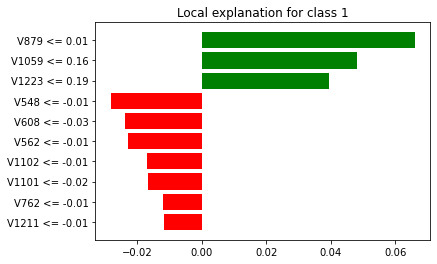

In [32]:
exp.as_pyplot_figure(label = 1);

In [33]:
exp.show_in_notebook(labels = [1])

In [34]:
dd = X_new.loc[y == 1,:]
dd.shape

(2500, 381)

In [40]:
explainer = shap.Explainer(model.predict, dd.iloc[2450:2500,:])
shap_values = explainer(dd.iloc[2450:2500,:], max_evals = 600)

InternalError: Failed copying input tensor from /job:localhost/replica:0/task:0/device:CPU:0 to /job:localhost/replica:0/task:0/device:GPU:0 in order to run _EagerConst: Dst tensor is not initialized.

In [36]:
shap_values

.values =
array([[ 5.34309074e-06,  0.00000000e+00,  1.01607980e-03, ...,
        -9.05422028e-05,  0.00000000e+00, -8.07722058e-04],
       [ 1.10630164e-05,  0.00000000e+00, -5.44796814e-04, ...,
        -8.51597637e-05,  0.00000000e+00, -3.18490547e-04],
       [ 1.12906423e-05,  0.00000000e+00, -3.91456764e-04, ...,
        -1.75009482e-05,  0.00000000e+00, -8.35050270e-04],
       ...,
       [ 1.80071871e-05,  0.00000000e+00,  1.36949400e-02, ...,
         5.82917522e-04,  0.00000000e+00, -1.24047884e-02],
       [ 1.67505317e-05,  0.00000000e+00, -3.41591101e-03, ...,
         6.29200245e-04,  0.00000000e+00, -1.15517998e-03],
       [ 5.97862527e-07,  0.00000000e+00,  1.73318945e-04, ...,
         1.20287433e-04,  0.00000000e+00, -1.09491404e-05]])

.base_values =
array([[0.89823777],
       [0.89823777],
       [0.89823777],
       [0.89823777],
       [0.89823777],
       [0.89823777],
       [0.89823777],
       [0.89823777],
       [0.89823777],
       [0.89823777],
       

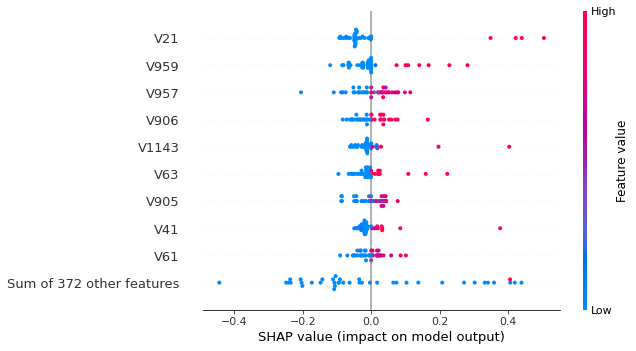

In [37]:
shap.plots.beeswarm(shap_values)

In [303]:
shap.force_plot(0.825, shap_values.values, shap_values.data, figsize=(1, 3))

# t-SNE

In [11]:
from time import time
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.ticker import NullFormatter
from sklearn import manifold
from sklearn.utils import check_random_state

# Unused but required import for doing 3d projections with matplotlib < 3.2
import mpl_toolkits.mplot3d  # noqa: F401
import warnings

In [8]:
from sklearn.preprocessing import LabelBinarizer
from sklearn.cluster import AgglomerativeClustering
from matplotlib.colors import ListedColormap

In [9]:
data = pd.read_csv("C:/Users/apoghosyan/Desktop/Ani Capstone/ani.csv", index_col = False)
data.drop('Unnamed: 0', axis = 1, inplace = True)
X = data.drop(['Health'], axis = 1)
y = data['Health']
mod = LabelBinarizer()
y = mod.fit_transform(y)

In [32]:
dist_out = 1 - np.abs(X.corr())

In [33]:
n = 20
model = AgglomerativeClustering(affinity = 'precomputed', n_clusters = n, linkage = 'complete').fit(dist_out)
model.labels_

array([ 5,  5,  5, ...,  7, 16, 10], dtype=int64)

C:\Users\apoghosyan\anaconda3\envs\gpu\lib\site-packages\sklearn\manifold\_t_sne.py:986: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  FutureWarning,


Text(0.5, 1.0, 'Observations')

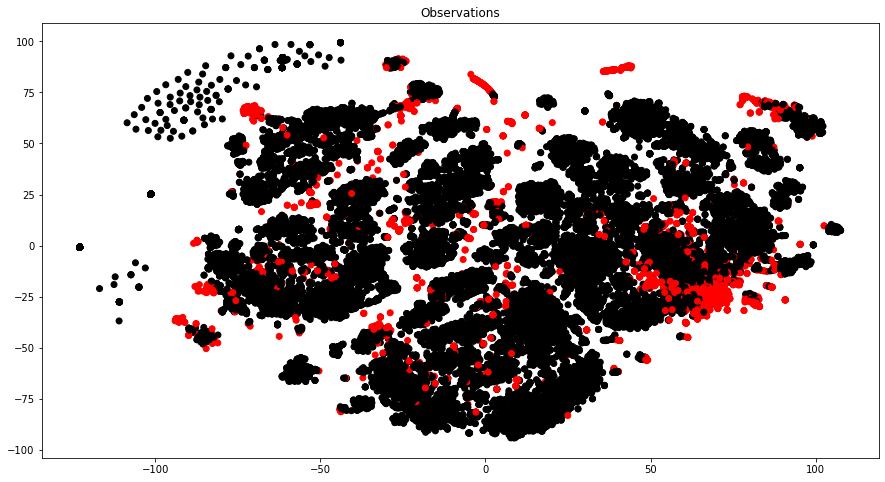

In [34]:
tsne = manifold.TSNE(n_components = 2,  random_state=0, learning_rate = "auto", init = 'pca')
trans_data = tsne.fit_transform(X).T

plt.figure(figsize=(15,8))
plt.scatter(trans_data[0], trans_data[1], c = y.ravel(), cmap =  ListedColormap(['black','red']))
plt.title('Observations')

C:\Users\apoghosyan\anaconda3\envs\gpu\lib\site-packages\sklearn\manifold\_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
C:\Users\apoghosyan\anaconda3\envs\gpu\lib\site-packages\sklearn\manifold\_t_sne.py:827: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  FutureWarning,


Text(0.5, 1.0, 'Features')

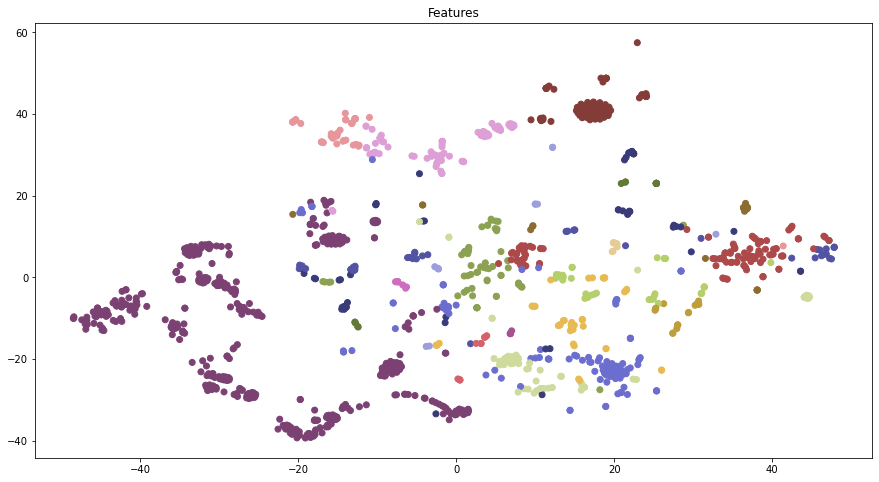

In [35]:
tsne = manifold.TSNE(n_components = 2,  random_state=0, learning_rate = "auto", metric = 'precomputed')
trans_data = tsne.fit_transform(abs(dist_out)).T

plt.figure(figsize=(15,8))
plt.scatter(trans_data[0], trans_data[1], c = model.labels_, cmap = 'tab20b')
plt.title('Features')

In [238]:
tsne = manifold.TSNE(n_components = 2,  random_state=0, learning_rate = "auto", init = 'pca')
trans_data = tsne.fit_transform(X).T

The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.


In [239]:
outliers_fraction = 0.01

algorithm =     EllipticEnvelope(contamination = outliers_fraction)
algorithm.fit(trans_data.T)

EllipticEnvelope(contamination=0.01)

Text(0.5, 1.0, 'Observations')

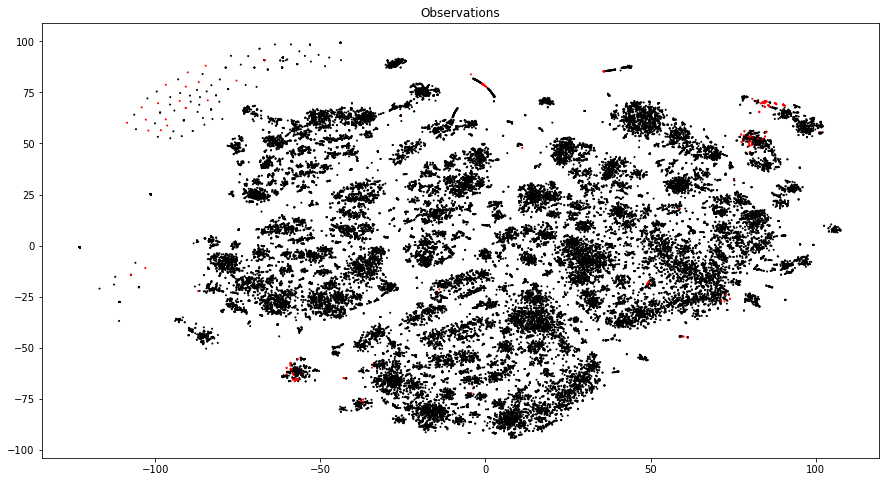

In [240]:
plt.figure(figsize=(15,8))
plt.scatter(trans_data[0], trans_data[1], 
            c = y_pred, 
            cmap =  ListedColormap(['red','black']),
            s=1)
plt.title('Observations')

In [26]:
from mpl_toolkits import mplot3d
from matplotlib.colors import ListedColormap

In [27]:
tsne = manifold.TSNE(n_components = 3, random_state=0, learning_rate = "auto", init = 'pca')
trans_data = tsne.fit_transform(X_new).T

The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.


Text(0.5, 0.92, 'Observations')

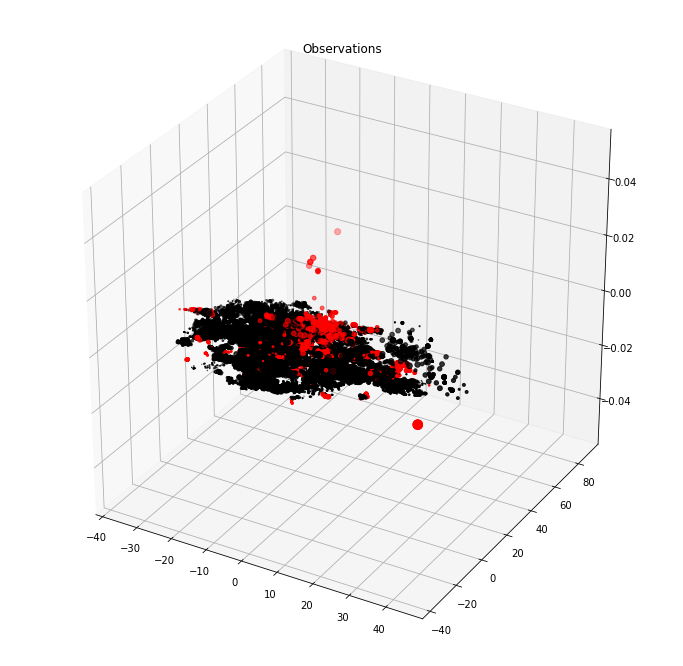

In [50]:
fig = plt.figure(figsize = (12,12))
ax = plt.axes(projection = '3d')
plt.scatter(trans_data[0], trans_data[1], trans_data[2], c = y.ravel(), 
            cmap =  ListedColormap(['black','red']))
plt.title('Observations')

In [ ]:
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score

In [166]:
def SS(data):
    score_list = []
    for eps in np.linspace(9, 20, 50):
        for min_samples in np.arange(5, 10, 1):
            
            model = DBSCAN(eps = eps, min_samples = min_samples)
            model.fit(data)
            
            labels = len(np.unique(model.labels_))
            percentage_of_outliers = np.sum(model.labels_ == -1)/data.shape[0]*100
            threshold_for_outliers = 3
            count_of_outliers = np.sum(np.unique(model.labels_) == -1)
            if (count_of_outliers == 0):
                number_of_clusters = labels
            else:
                number_of_clusters = labels - 1
            if (number_of_clusters == 0) or (number_of_clusters > 10) or (percentage_of_outliers > 3) or (number_of_clusters == 1):
                score = -1
            elif (count_of_outliers == 0):
                score = silhouette_score(data, model.labels_)
            else:
                data_new = data[model.labels_ > -1, :]
                new_labels = model.labels_[model.labels_ > -1]
                score = silhouette_score(data_new, new_labels)
            
            if score > 0.5:
                print((percentage_of_outliers, number_of_clusters, eps, min_samples, score))
                score_list.append((eps, min_samples, score))
    
    return score_list

In [167]:
SS(trans_data.T)

KeyboardInterrupt: 

In [230]:
from sklearn.linear_model import SGDOneClassSVM
from sklearn.neighbors import LocalOutlierFactor
from sklearn.covariance import EllipticEnvelope

outliers_fraction = 0.01

algorithm =     EllipticEnvelope(contamination=outliers_fraction)
algorithm.fit(trans_data.T)

EllipticEnvelope(contamination=0.01)

In [231]:
 y_pred = algorithm.predict(trans_data.T)

invalid value encountered in sqrt


Text(0.5, 0.92, 'Observations')

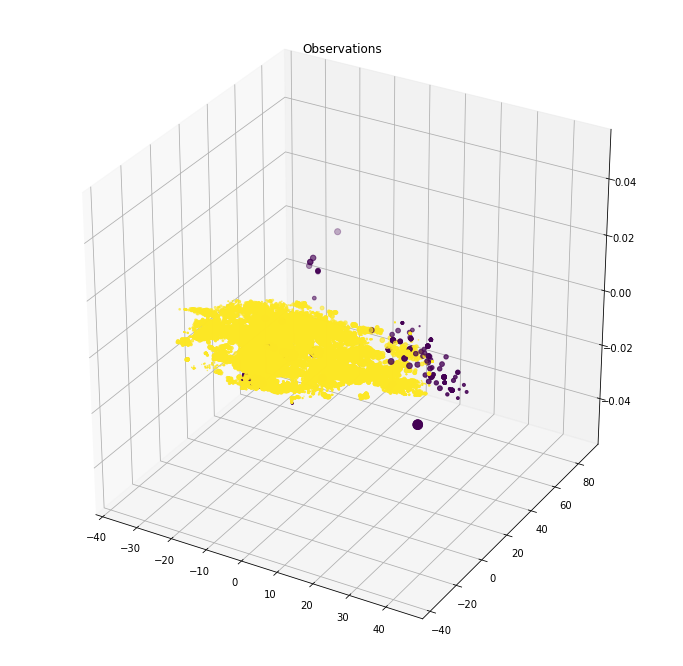

In [232]:
fig = plt.figure(figsize = (12,12))
ax = plt.axes(projection = '3d')
plt.scatter(trans_data[0], trans_data[1], trans_data[2], c = y_pred)
plt.title('Observations')

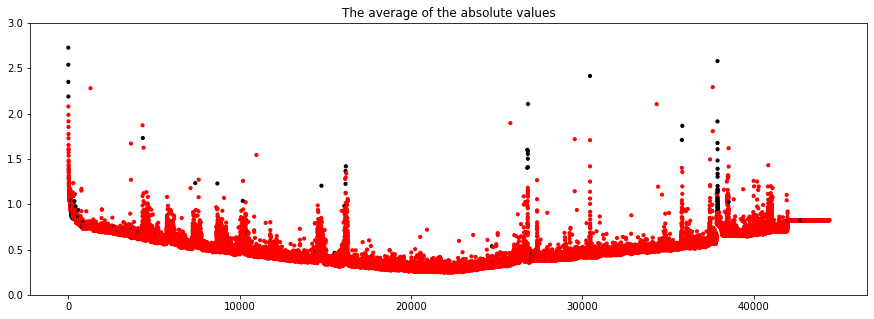

In [233]:
from matplotlib import cm
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
cmap = ListedColormap(["black", "red"])
plt.figure(figsize = (15,5))
plt.scatter(np.arange(len(y.values)), abs(X.values).mean(axis = 1), 
            c = y_pred, cmap = cmap, s = 10)
plt.ylim(0,3)
plt.title('The average of the absolute values')
plt.show()

In [199]:
np.sum(y_pred == 1)

44088

In [200]:
np.unique(y_pred)

array([-1,  1])